In [22]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

In [23]:
df = pd.read_csv("../DATA/DATA[7].csv")

In [24]:
df.head()

,fw,gl,gh,il,iw,sh,pl,pw,sl,sw,ph,freq,s11,gain
0,1,30,2.0,2.0,2.0,3.0,30.0,32.0,35,40,2.0,12.048,-11.151591,7.620903
1,1,30,2.0,2.0,2.0,2.5,30.0,32.0,35,40,2.0,12.228,-11.503540,6.824743
2,1,30,2.0,2.0,2.0,2.0,30.0,32.0,35,40,2.0,12.540,-9.988415,7.222227
3,1,30,2.0,2.0,2.0,1.5,30.0,32.0,35,40,2.0,12.636,-9.034343,8.771821
4,1,30,2.0,2.0,2.0,3.0,30.0,32.0,35,40,1.3,12.084,-8.643851,7.654894


In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16381 entries, 0 to 16380
Data columns (total 14 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   fw      16381 non-null  int64  
 1   gl      16381 non-null  int64  
 2   gh      16381 non-null  float64
 3   il      16381 non-null  float64
 4   iw      16381 non-null  float64
 5   sh      16381 non-null  float64
 6   pl      16381 non-null  float64
 7   pw      16381 non-null  float64
 8   sl      16381 non-null  int64  
 9   sw      16381 non-null  int64  
 10  ph      16381 non-null  float64
 11  freq    16381 non-null  float64
 12  s11     16381 non-null  float64
 13  gain    16381 non-null  float64
dtypes: float64(10), int64(4)
memory usage: 1.7 MB


In [26]:
from sklearn.model_selection import train_test_split

train, test = train_test_split(df, random_state=22051662)

In [27]:
train.head()

,fw,gl,gh,il,iw,sh,pl,pw,sl,sw,ph,freq,s11,gain
1525,1,30,1.0,2.0,1.3,2.5,29.5,30.5,35,40,1.3,12.588,-10.122371,8.458755
7034,1,30,1.0,1.8,0.7,3.0,28.5,31.5,35,40,0.1,18.000,-6.739633,8.149894
14307,1,30,1.4,1.0,1.3,2.0,28.5,30.5,35,40,1.3,13.020,-11.419055,8.263785
13267,1,30,1.8,1.0,2.0,2.0,28.5,30.5,35,40,1.3,13.020,-10.152213,8.440083
10252,1,30,2.0,1.4,0.7,1.5,30.0,32.0,35,40,0.1,12.678,-5.791455,9.180185


In [28]:
test.head()

,fw,gl,gh,il,iw,sh,pl,pw,sl,sw,ph,freq,s11,gain
2111,1,30,1.0,2.0,0.7,1.5,30.0,32.0,35,40,0.1,12.282,-4.940336,9.803912
3342,1,30,2.0,2.0,0.1,2.5,29.5,32.0,35,40,0.1,12.534,-6.895726,7.687652
10851,1,30,1.4,1.4,0.7,2.0,29.0,31.5,35,40,1.3,12.834,-11.218559,8.174739
14051,1,30,1.4,1.0,1.3,2.0,29.0,30.5,35,40,1.3,12.942,-13.527624,8.256642
3688,1,30,1.4,2.0,0.1,3.0,29.0,31.5,35,40,0.7,12.486,-11.287022,6.540366


In [29]:
xcols = ['gh', 'il', 'iw', 'sh', 'pl', 'pw', 'ph']
ycols = ['freq', 's11', 'gain']

In [30]:
vis = df[xcols + ycols]

In [31]:
vis.max()

gh       2.000000
il       2.000000
iw       2.000000
sh       3.000000
pl      30.000000
pw      32.000000
ph       2.000000
freq    18.000000
s11     -4.051156
gain    10.146685
dtype: float64

In [32]:
vis.min()

gh       1.000000
il       1.000000
iw       0.100000
sh       1.500000
pl      28.500000
pw      30.500000
ph       0.100000
freq    12.000000
s11    -63.497634
gain     5.053728
dtype: float64

In [33]:
X_train, X_test = train[xcols].values, test[xcols].values
y_train, y_test = train[ycols].values, test[ycols].values

## DATA VISUALIZATION

In [34]:
import matplotlib.pyplot as plt
import seaborn as sns

selected_columns = xcols + ycols
figsize = (15, 10) 

HISTOGRAM

<Figure size 7500x5000 with 0 Axes>

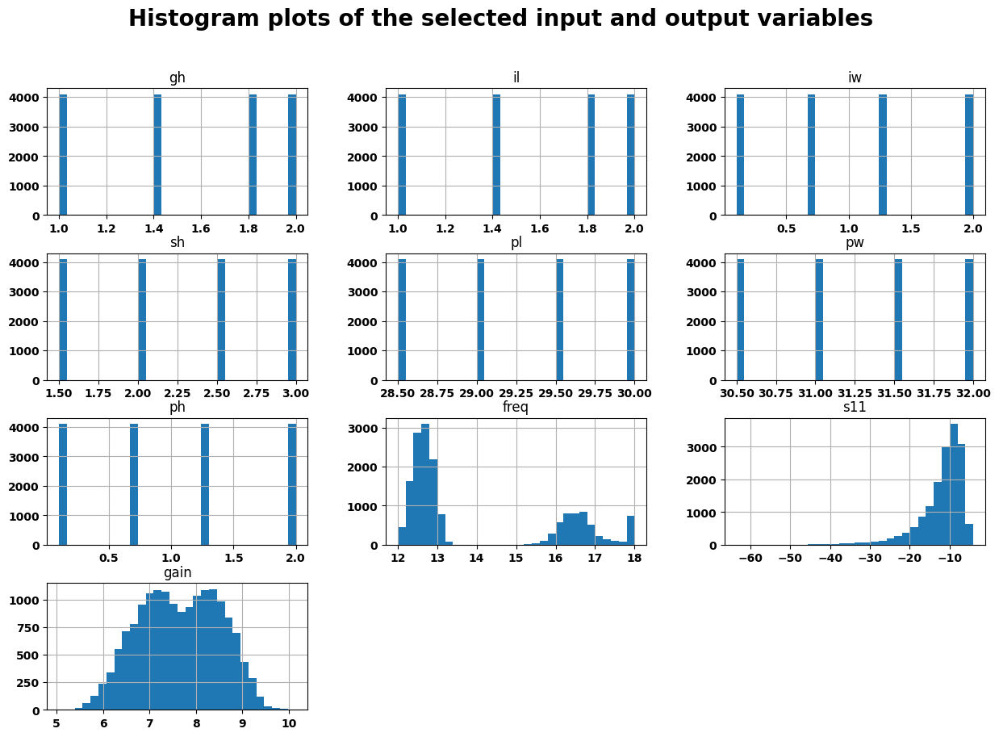

In [35]:
plt.figure(figsize=figsize, dpi=500)
df[selected_columns].hist(bins=30, figsize=figsize)

plt.suptitle('Histogram plots of the selected input and output variables', fontsize=20, fontweight='bold') 
plt.xlabel('Variables', fontsize=16, fontweight='bold') 
plt.ylabel('Frequency', fontsize=16, fontweight='bold') 

for ax in plt.gcf().get_axes():
    for label in ax.get_xticklabels() + ax.get_yticklabels():
        label.set_fontweight('bold')

# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\Histogram.png', dpi=500)
plt.show()

CORRELATION MATRIX

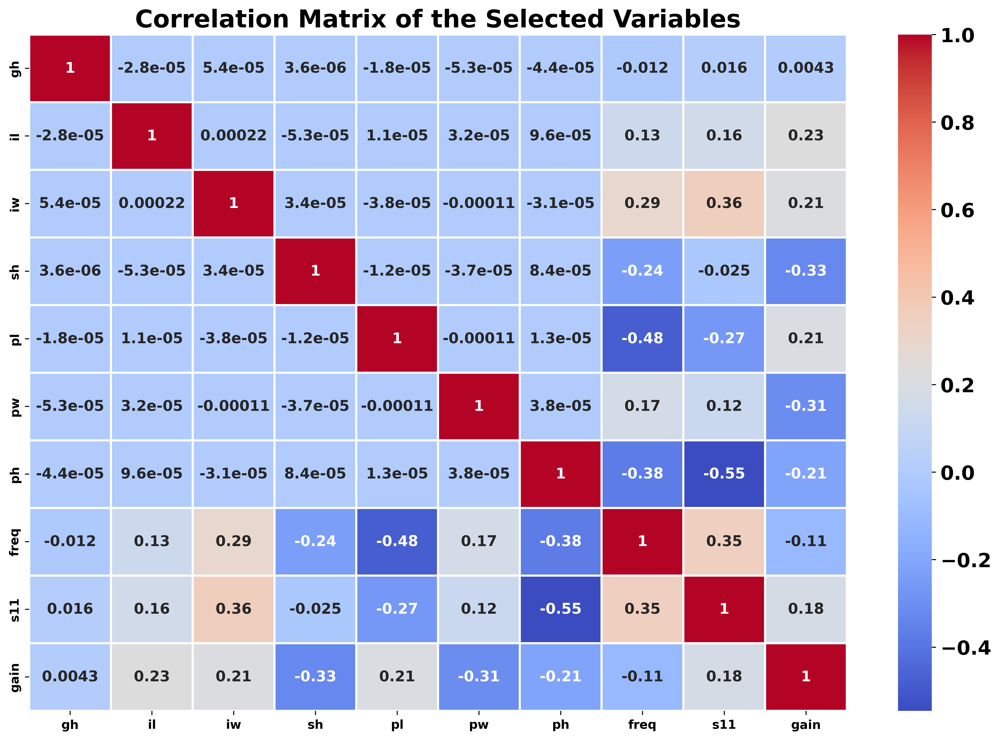

In [36]:
corr_matrix = df[selected_columns].corr()

plt.figure(figsize=figsize, dpi=500)
heatmap = sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=1.5, annot_kws={"size": 12, "weight": "bold"}) 

plt.title('Correlation Matrix of the Selected Variables', fontsize=20, fontweight='bold')
plt.xticks(fontweight='bold')
plt.yticks(fontweight='bold')

colorbar = heatmap.collections[0].colorbar
colorbar.ax.tick_params(labelsize=16)  
for label in colorbar.ax.get_yticklabels():
    label.set_fontweight('bold') 

# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\CorrelationMatrix.png', dpi=500)
plt.show()

In [37]:
from sklearn.preprocessing import MinMaxScaler

In [38]:
Scaler_X = MinMaxScaler().fit(X_train)
Scaler_Y = MinMaxScaler().fit(y_train)

In [39]:
X_train_scaled = Scaler_X.transform(X_train)
X_test_scaled = Scaler_X.transform(X_test)

y_train_scaled = Scaler_Y.transform(y_train)
y_test_scaled = Scaler_Y.transform(y_test)

In [40]:
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Input

model = Sequential()

model.add(Input(shape=(X_train_scaled.shape[1],)))
model.add(Dense(27, activation='relu'))
model.add(Dense(81, activation='relu'))
model.add(Dense(486, activation='relu'))
model.add(Dense(81, activation='relu'))
model.add(Dense(3, activation='linear'))

model.compile(
    loss='mean_squared_error', 
    optimizer='adam', 
    metrics=['mae', 'mse', 'accuracy', 'r2_score'],
    jit_compile='auto'
)

model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 27)             │           216 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 81)             │         2,268 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 486)            │        39,852 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 81)             │        39,447 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 3)              │           246 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 82,029 (320.43 KB)

 Trainable params: 82,029 (320.43 KB)

 Non-trainable params: 0 (0.00 B)

In [41]:
EPOCHS = 5000

history = model.fit(
    X_train_scaled, y_train_scaled,
    validation_split=0.2,
    epochs=EPOCHS
)

Epoch 1/5000
308/308 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.8789 - loss: 0.0605 - mae: 0.1676 - mse: 0.0605 - r2_score: -2.1847 - val_accuracy: 0.9324 - val_loss: 0.0149 - val_mae: 0.0767 - val_mse: 0.0149 - val_r2_score: 0.6636
Epoch 2/5000
308/308 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.9251 - loss: 0.0130 - mae: 0.0705 - mse: 0.0130 - r2_score: 0.7242 - val_accuracy: 0.8991 - val_loss: 0.0124 - val_mae: 0.0681 - val_mse: 0.0124 - val_r2_score: 0.7525
Epoch 3/5000
308/308 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.9366 - loss: 0.0105 - mae: 0.0603 - mse: 0.0105 - r2_score: 0.7727 - val_accuracy: 0.9377 - val_loss: 0.0100 - val_mae: 0.0554 - val_mse: 0.0100 - val_r2_score: 0.7878
Epoch 4/5000
308/308 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step - accuracy: 0.9416 - loss: 0.0087 - mae: 0.0523 - mse: 0.0087 - r2_score: 0.8210 - val_accuracy: 0.9263 - val_loss: 0.0097 - val_mae: 0.0541 - val_mse: 0.0097 - val_r2_score: 0.7835
Epoch 5/5000
308/308 ━━━━━━━━━━━━━━━━━━━━ 1s 2ms/step -

In [42]:
model.get_metrics_result()

{'accuracy': 0.9784289598464966,
 'loss': 0.0047243800945580006,
 'mae': 0.021762123331427574,
 'mse': 0.0047243800945580006,
 'r2_score': 0.9182551503181458}

128/128 ━━━━━━━━━━━━━━━━━━━━ 0s 769us/step


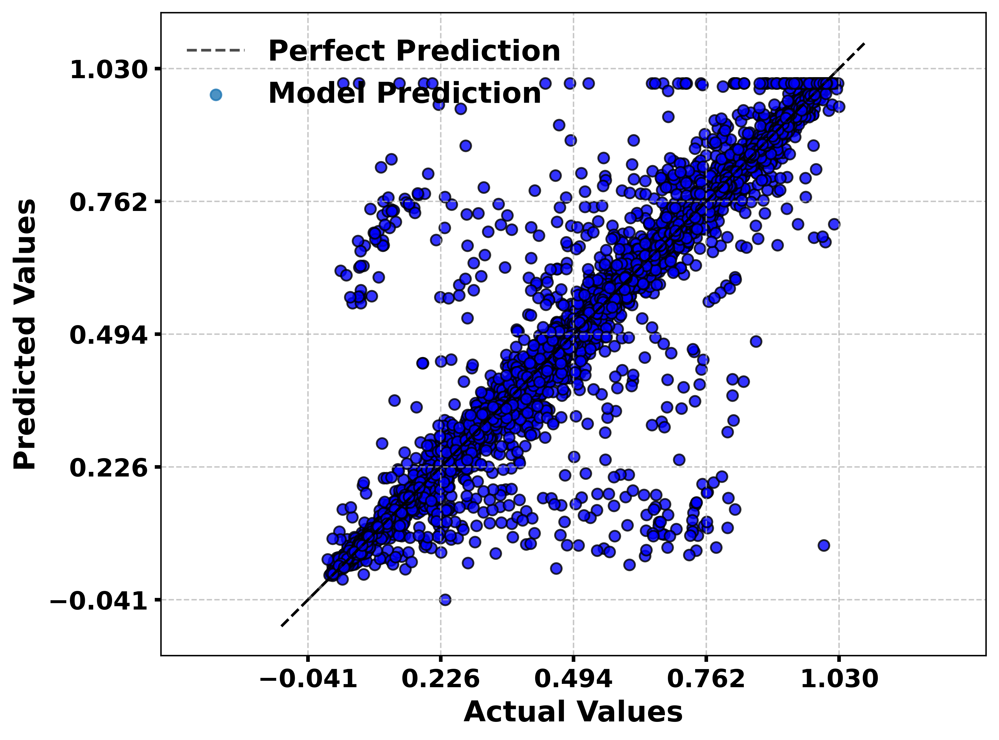

R² Score: 0.9161
Mean Absolute Error (MAE): 0.0225
Mean Squared Error (MSE): 0.0052
Explained Variance Score: 0.9163


In [43]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, explained_variance_score
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import PredictionErrorDisplay

plt.rcParams.update({'font.size': 16})

def plot_predictions(model, X_test_scaled, y_test_scaled):
    predicted = model.predict(X_test_scaled)
    

    display = PredictionErrorDisplay(y_true=y_test_scaled, y_pred=predicted)    
    fig, ax = plt.subplots(figsize=(8, 6), dpi=500)
    display.plot(kind="actual_vs_predicted", ax=ax)
 
    ax.set_xlabel("Actual Values", fontsize=16, fontweight='bold') 
    ax.set_ylabel("Predicted Values", fontsize=16, fontweight='bold') 
    ax.tick_params(axis='both', which='major', labelsize=14, width=2)
    for label in ax.get_xticklabels() + ax.get_yticklabels():
        label.set_fontweight('bold')

    ax.grid(True, linestyle='--', alpha=0.7)
    ax.plot(ax.get_xlim(), ax.get_ylim(), ls="--", c="black") 
    
    legend = ax.legend(['Perfect Prediction', 'Model Prediction'], loc='upper left', fontsize=16, frameon=False)
    for text in legend.get_texts():
        text.set_fontweight('bold')

    ax.lines[0].set_color('black') 
    ax.collections[0].set_edgecolor('black') 
    ax.collections[0].set_facecolor('blue')

    plt.tight_layout()
    # plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\NeuralNetwork.png', dpi=500)
    plt.show()

    return predicted


predicted = plot_predictions(model, X_test_scaled, y_test_scaled)

r2 = r2_score(y_test_scaled, predicted)
mae = mean_absolute_error(y_test_scaled, predicted)
mse = mean_squared_error(y_test_scaled, predicted)
explained_variance = explained_variance_score(y_test_scaled, predicted)

print(f"\033[1mR² Score:\033[0m {r2:.4f}")
print(f"\033[1mMean Absolute Error (MAE):\033[0m {mae:.4f}")
print(f"\033[1mMean Squared Error (MSE):\033[0m {mse:.4f}")
print(f"\033[1mExplained Variance Score:\033[0m {explained_variance:.4f}")

In [44]:
accuracy = history.history['accuracy']
val_accuracy = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

mae = history.history['mae']
val_mae = history.history['val_mae']

mse = history.history['mse']
val_mse = history.history['val_mse']

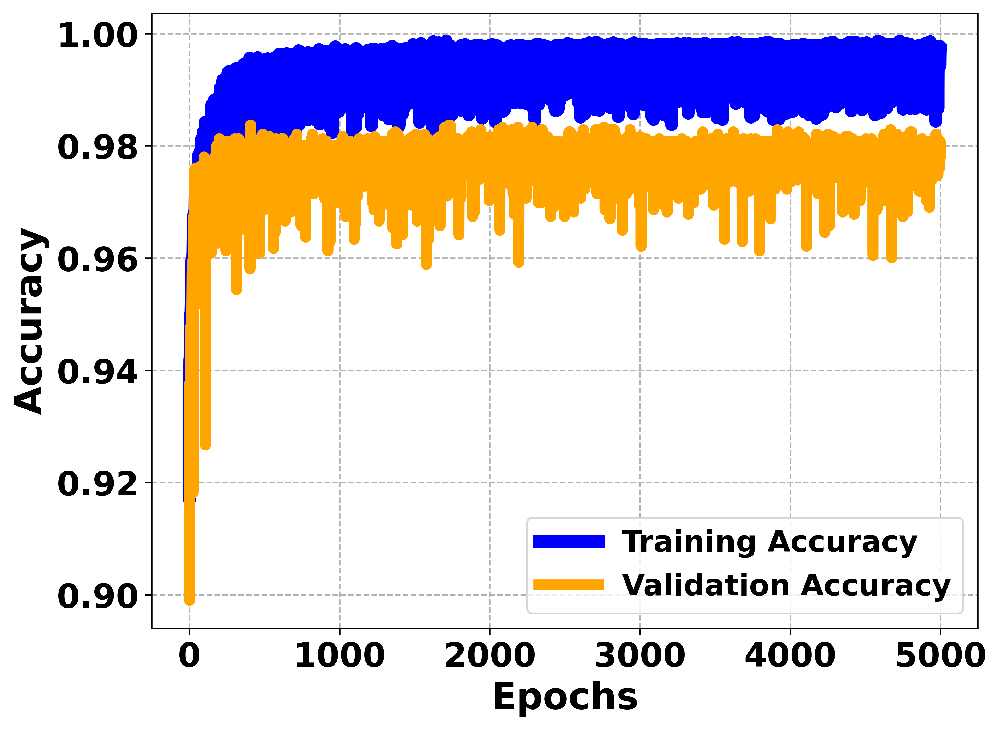

In [45]:

plt.figure(figsize=(8, 6), dpi=500)
plt.plot(accuracy, label='Training Accuracy', color='blue', linewidth=7, alpha=1)
plt.plot(val_accuracy, label='Validation Accuracy', color='orange', linewidth=6, alpha=1)
plt.xlabel('Epochs', fontsize=20, fontweight='bold')
plt.ylabel('Accuracy', fontsize=20, fontweight='bold')
plt.xticks(fontsize=18, fontweight='bold')
plt.yticks(fontsize=18, fontweight='bold')
plt.legend(fontsize=18, prop={'weight': 'bold'})  
plt.grid(True, linestyle='--', alpha=1)
# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\Accuracy.png', dpi=500)
plt.show()

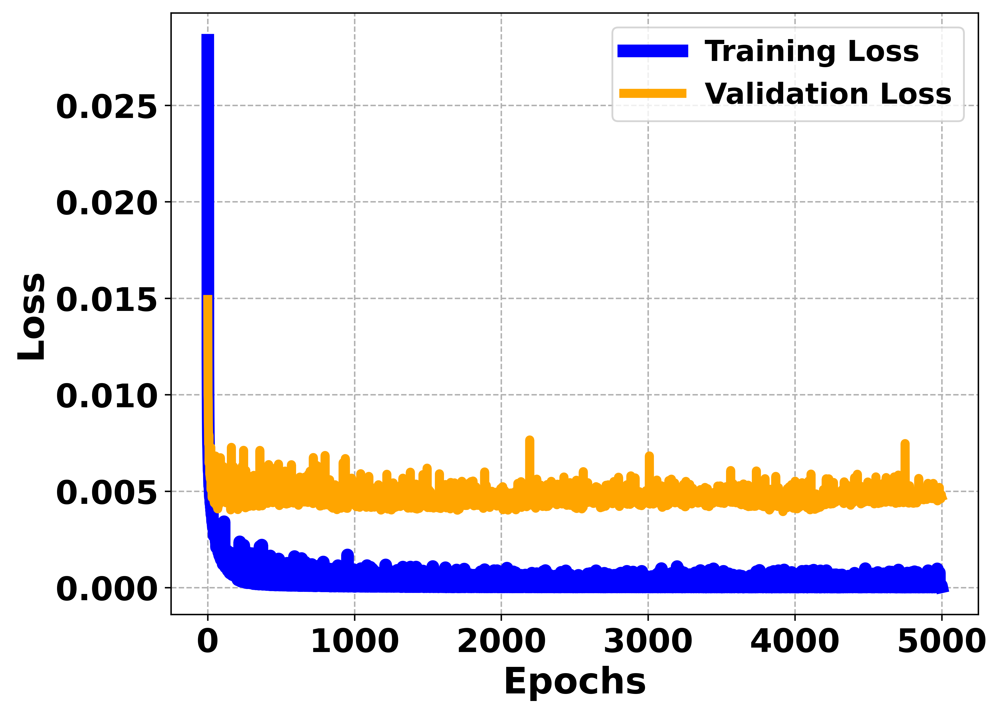

In [46]:
plt.figure(figsize=(8, 6), dpi=500)
plt.plot(loss, label='Training Loss', color='blue', linewidth=7, alpha=1)
plt.plot(val_loss, label='Validation Loss', color='orange', linewidth=5, alpha=1)
plt.xlabel('Epochs', fontsize=20, fontweight='bold')
plt.ylabel('Loss', fontsize=20, fontweight='bold')
plt.xticks(fontsize=18, fontweight='bold')
plt.yticks(fontsize=18, fontweight='bold')
plt.legend(fontsize=18, prop={'weight': 'bold'}) 
plt.grid(True, linestyle='--', alpha=1)
# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\Loss.png', dpi=500)
plt.show()

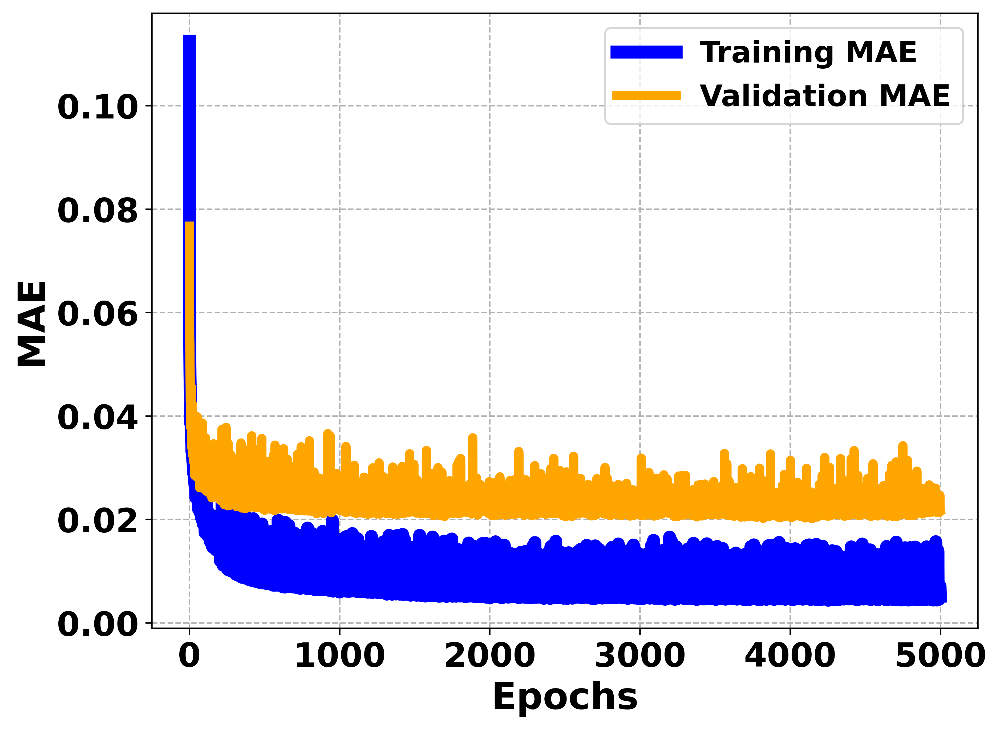

In [47]:
plt.figure(figsize=(8, 6), dpi=500)
plt.plot(mae, label='Training MAE', color='blue', linewidth=7, alpha=1)
plt.plot(val_mae, label='Validation MAE', color='orange', linewidth=5, alpha=1)
plt.xlabel('Epochs', fontsize=20, fontweight='bold')
plt.ylabel('MAE', fontsize=20, fontweight='bold')
plt.xticks(fontsize=18, fontweight='bold')
plt.yticks(fontsize=18, fontweight='bold')
plt.legend(fontsize=18, prop={'weight': 'bold'})  
plt.grid(True, linestyle='--', alpha=1)
# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\MAE.png', dpi=500)
plt.show()

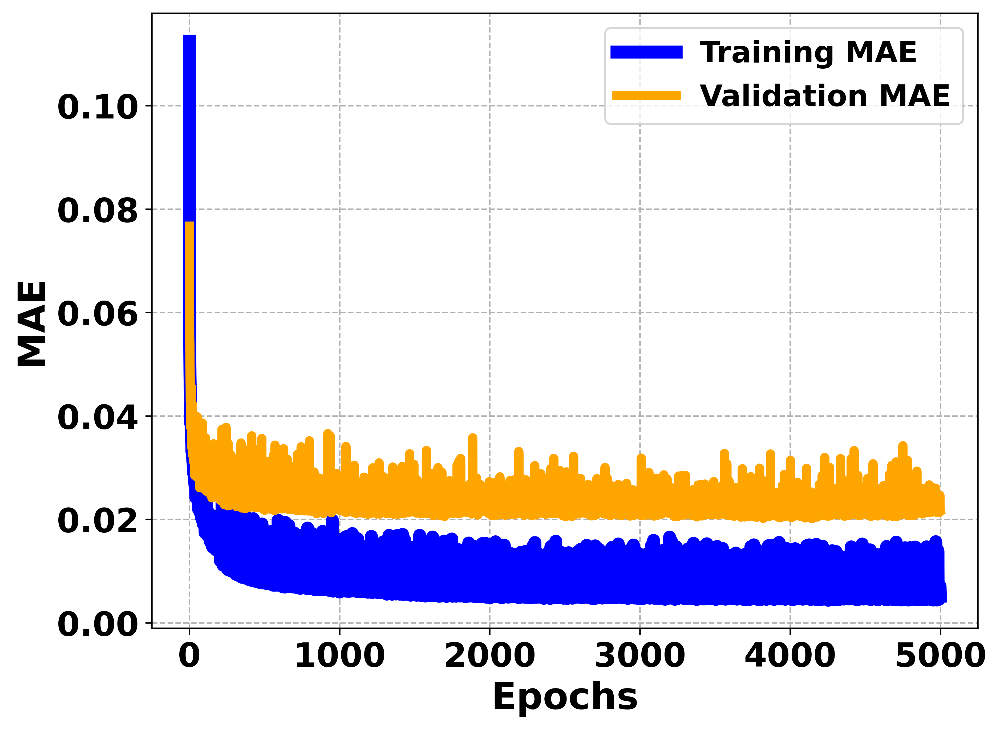

In [48]:
plt.figure(figsize=(8, 6), dpi=500)
plt.plot(mae, label='Training MAE', color='blue', linewidth=7, alpha=1)
plt.plot(val_mae, label='Validation MAE', color='orange', linewidth=5, alpha=1)
plt.xlabel('Epochs', fontsize=20, fontweight='bold')
plt.ylabel('MAE', fontsize=20, fontweight='bold')
plt.xticks(fontsize=18, fontweight='bold')
plt.yticks(fontsize=18, fontweight='bold')
plt.legend(fontsize=18, prop={'weight': 'bold'})  
plt.grid(True, linestyle='--', alpha=1)
# plt.savefig(r'C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\MAE.png', dpi=500)
plt.show()

## SK-LEARN

In [49]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error, explained_variance_score
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 16})
from sklearn.metrics import PredictionErrorDisplay

def print_metrics(fname, bar, model, x_test_scaled, y_test):
    predicted = model.predict(x_test_scaled)

    print(f'\n{bar}\n' + '-' * len(bar))
    
    display = PredictionErrorDisplay(y_true=y_test, y_pred=predicted)
    
    fig, ax = plt.subplots(figsize=(8, 6), dpi=500)
    display.plot(kind="actual_vs_predicted", ax=ax)
     
    ax.set_xlabel("Actual Values", fontsize=16, fontweight='bold') 
    ax.set_ylabel("Predicted Values", fontsize=16, fontweight='bold') 

    ax.tick_params(axis='both', which='major', labelsize=14, width=2)
    for label in ax.get_xticklabels() + ax.get_yticklabels():
        label.set_fontweight('bold')


    ax.grid(True, linestyle='--', alpha=0.7)
    ax.plot(ax.get_xlim(), ax.get_ylim(), ls="--", c="black") 
    
    legend = ax.legend(['Perfect Prediction', 'Model Prediction'], loc='upper left', fontsize=16, frameon=False)
    for text in legend.get_texts():
        text.set_fontweight('bold')

    ax.lines[0].set_color('black') 
    ax.collections[0].set_edgecolor('black') 
    ax.collections[0].set_facecolor('blue')

    plt.tight_layout()
    # plt.savefig(r"C:\Users\KIIT\OneDrive\Documents\RESEARCH_PAPERS\SHARAD\DRAFTS\GHz\MANUSCRIPT\{}.png".format(fname), dpi=500)
    plt.show()
    
    print(f"\033[1mR² Score:\033[0m {r2_score(y_test, predicted):.4f}")
    print(f"\033[1mMean Absolute Error (MAE):\033[0m {mean_absolute_error(y_test, predicted):.4f}")
    print(f"\033[1mMean Squared Error (MSE):\033[0m {mean_squared_error(y_test, predicted):.4f}")
    print(f"\033[1mExplained Variance Score:\033[0m {explained_variance_score(y_test, predicted):.4f}")
    print()

### DUMMY REGRESSOR


Dummy Regressor
---------------


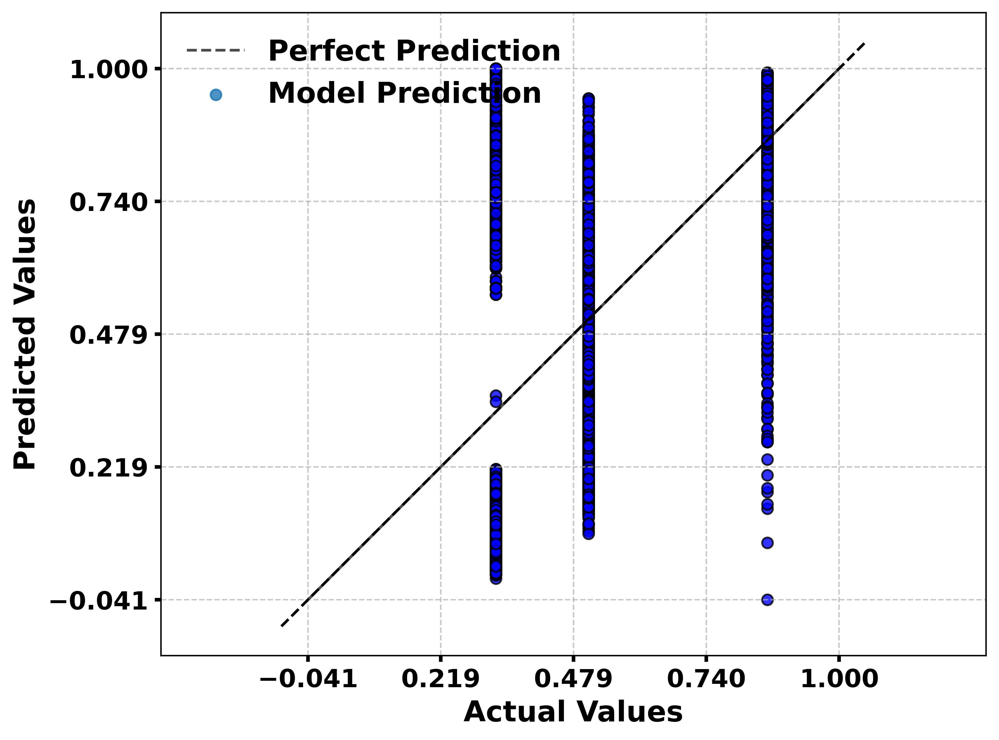

R² Score: -0.0001
Mean Absolute Error (MAE): 0.1714
Mean Squared Error (MSE): 0.0483
Explained Variance Score: 0.0000



In [50]:
from sklearn.dummy import DummyRegressor

dummy_reg = DummyRegressor(strategy="mean")
dummy_reg.fit(X_train_scaled, y_train_scaled)

print_metrics("DummyRegressor", "Dummy Regressor", dummy_reg, X_test_scaled, y_test_scaled)


### LINEAR MODELS

In [51]:
from sklearn import linear_model

Basic


Linear Regression Model
-----------------------


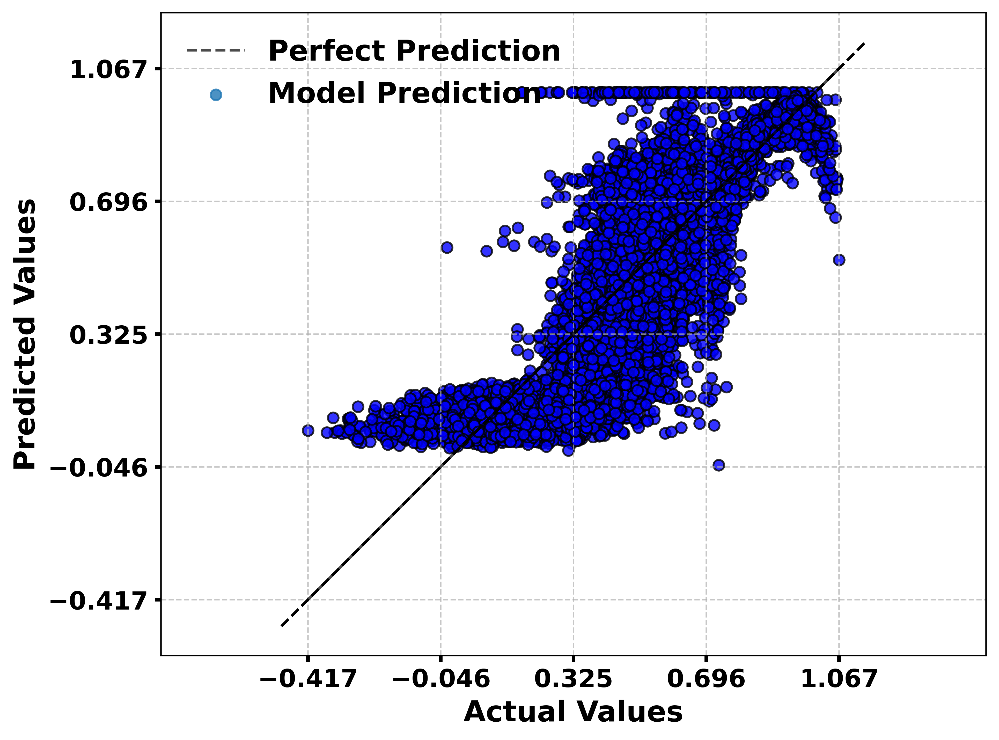

R² Score: 0.4992
Mean Absolute Error (MAE): 0.1105
Mean Squared Error (MSE): 0.0229
Explained Variance Score: 0.4993



In [52]:
linear = linear_model.LinearRegression()
linear.fit(X_train_scaled, y_train_scaled)

print_metrics("LinearRegression", "Linear Regression Model", linear, X_test_scaled, y_test_scaled)

### RIDGE REGRESSION


Ridge Regression Model
----------------------


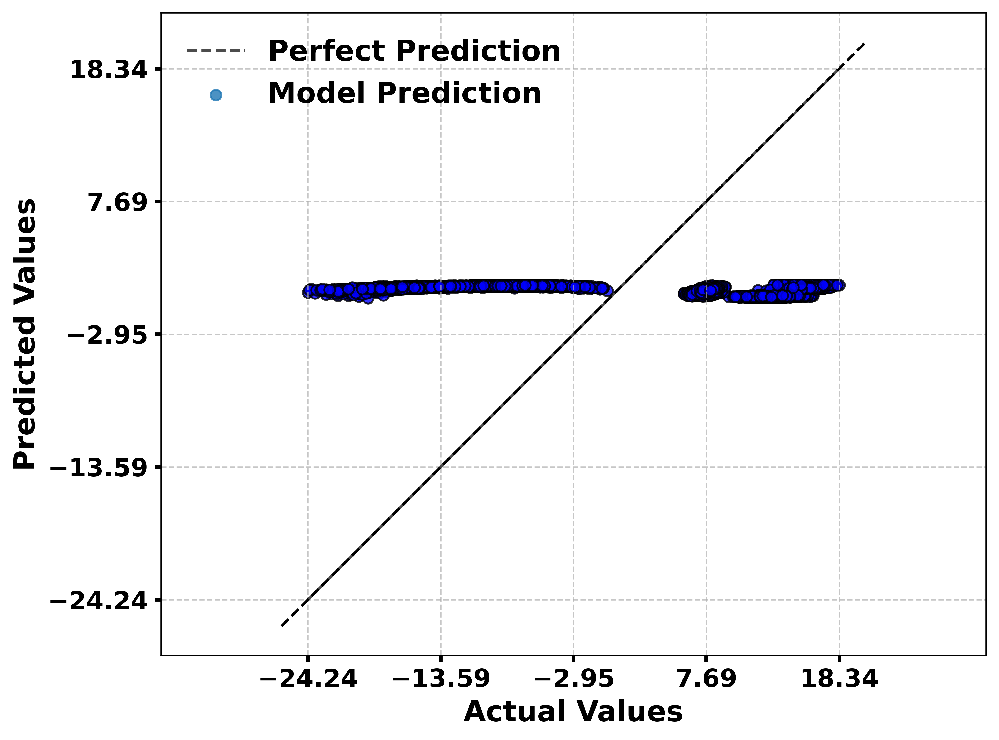

R² Score: -6800.1376
Mean Absolute Error (MAE): 11.2338
Mean Squared Error (MSE): 141.4389
Explained Variance Score: -567.3183



In [53]:
ridge_reg = linear_model.Ridge(alpha=.5)
ridge_reg.fit(X_train_scaled, y_train)

print_metrics("Ridge", "Ridge Regression Model", ridge_reg, X_test_scaled, y_test_scaled)

Bayesian Ridge


Bayesian Ridge Regression Model
-------------------------------


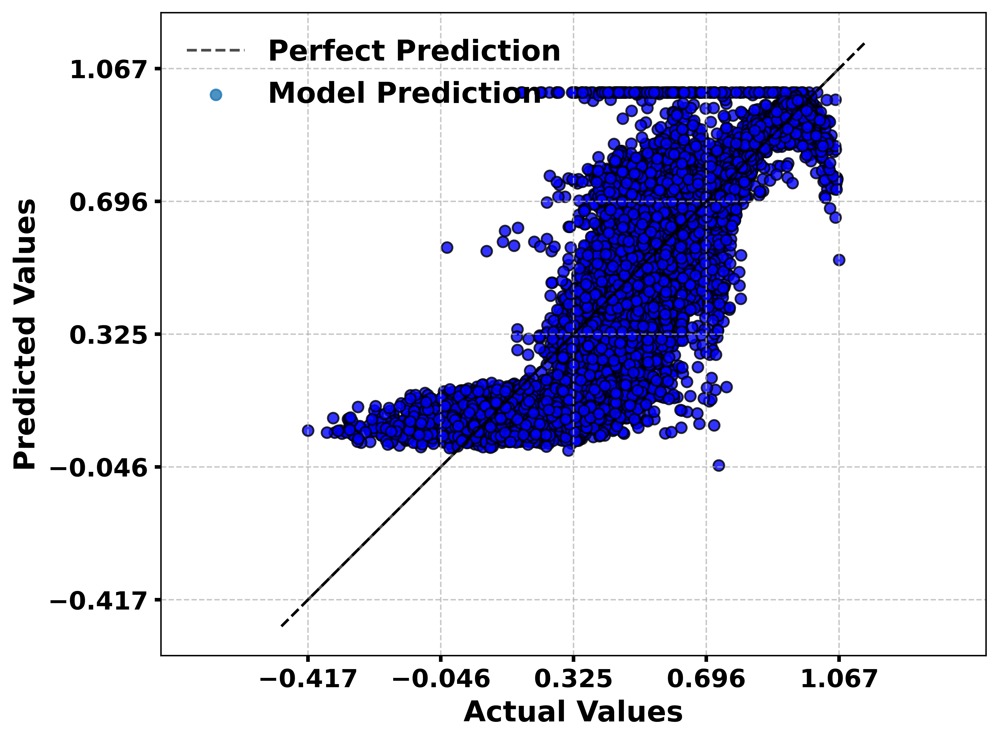

R² Score: 0.4992
Mean Absolute Error (MAE): 0.1105
Mean Squared Error (MSE): 0.0229
Explained Variance Score: 0.4993



In [54]:
from sklearn.multioutput import MultiOutputRegressor, RegressorChain

bayesian_redge_reg = MultiOutputRegressor(linear_model.BayesianRidge())
bayesian_redge_reg.fit(X_train_scaled, y_train_scaled)

print_metrics("LassoLarsBayesianRidge", "Bayesian Ridge Regression Model", bayesian_redge_reg, X_test_scaled, y_test_scaled)

### HIST GRADIENT BOOSTING


Histogram Gradient Boosting Regression Model
--------------------------------------------


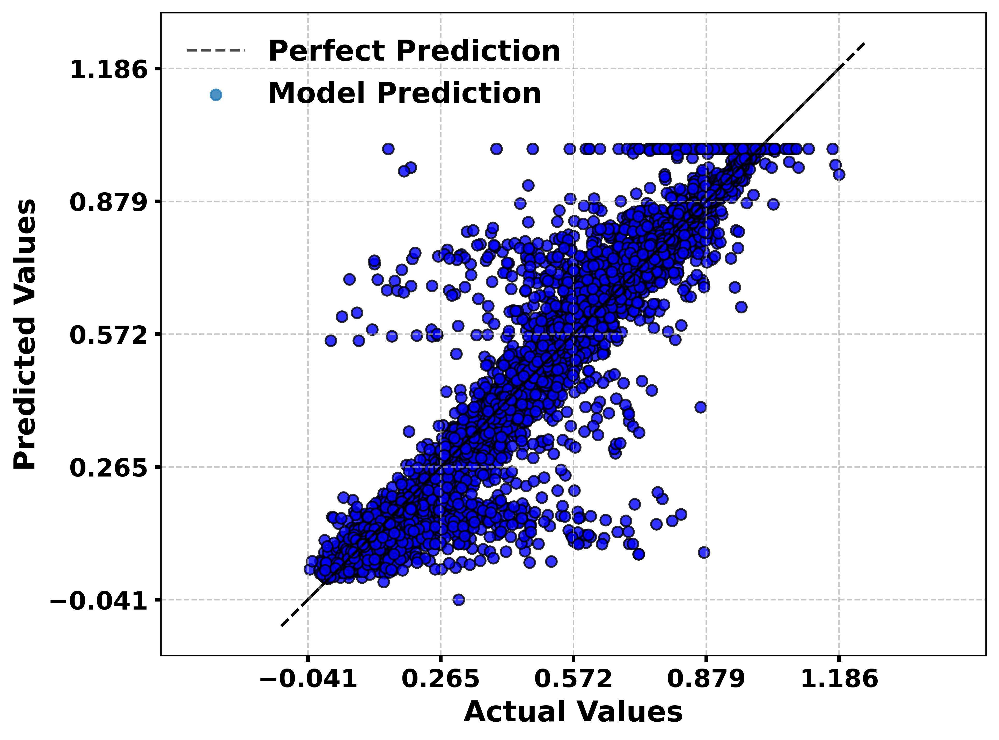

R² Score: 0.9220
Mean Absolute Error (MAE): 0.0298
Mean Squared Error (MSE): 0.0047
Explained Variance Score: 0.9220


Linear Regression with Polynomial Features
------------------------------------------


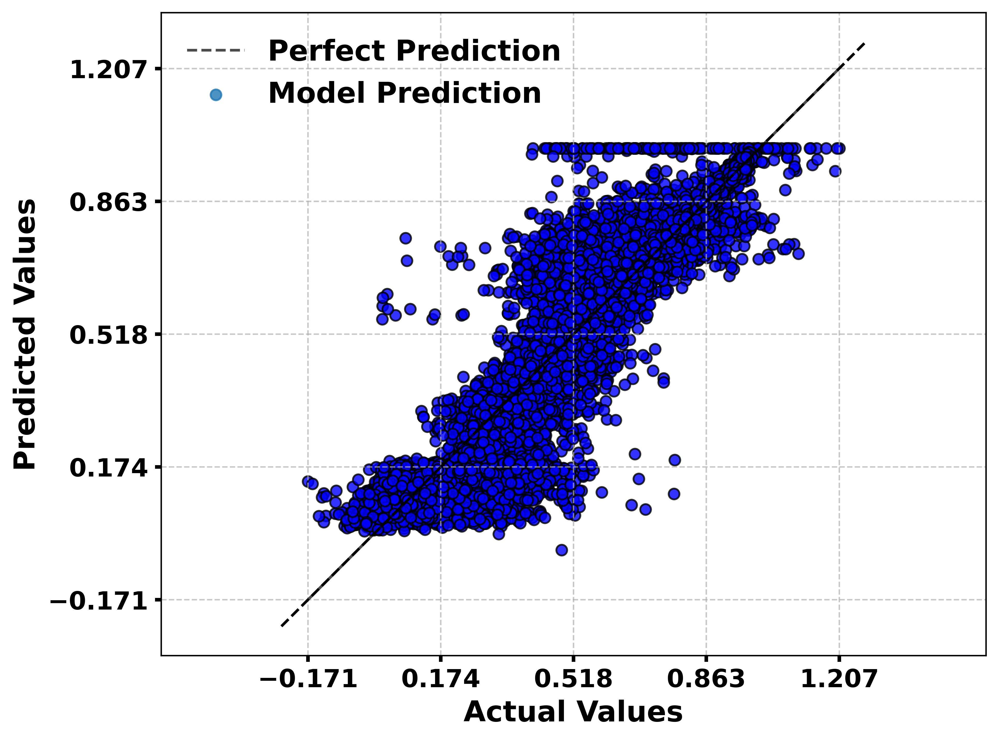

R² Score: 0.8172
Mean Absolute Error (MAE): 0.0629
Mean Squared Error (MSE): 0.0107
Explained Variance Score: 0.8172



In [55]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.multioutput import MultiOutputRegressor

poly = PolynomialFeatures(4)

hgbr_reg = MultiOutputRegressor(HistGradientBoostingRegressor(loss="squared_error", max_leaf_nodes=128))
X_train_poly = poly.fit_transform(X_train_scaled) 
hgbr_reg.fit(X_train_poly, y_train_scaled)

X_test_poly = poly.transform(X_test_scaled)  
print_metrics("HistRegression", "Histogram Gradient Boosting Regression Model", hgbr_reg, X_test_poly, y_test_scaled)

linear_poly = linear_model.LinearRegression(fit_intercept=False)
linear_poly.fit(X_train_poly, y_train_scaled)  

print_metrics("PolynomialRegression", "Linear Regression with Polynomial Features", linear_poly, X_test_poly, y_test_scaled)

### SVM

RBF


Support Vector Regression Model (RBF Kernel)
--------------------------------------------


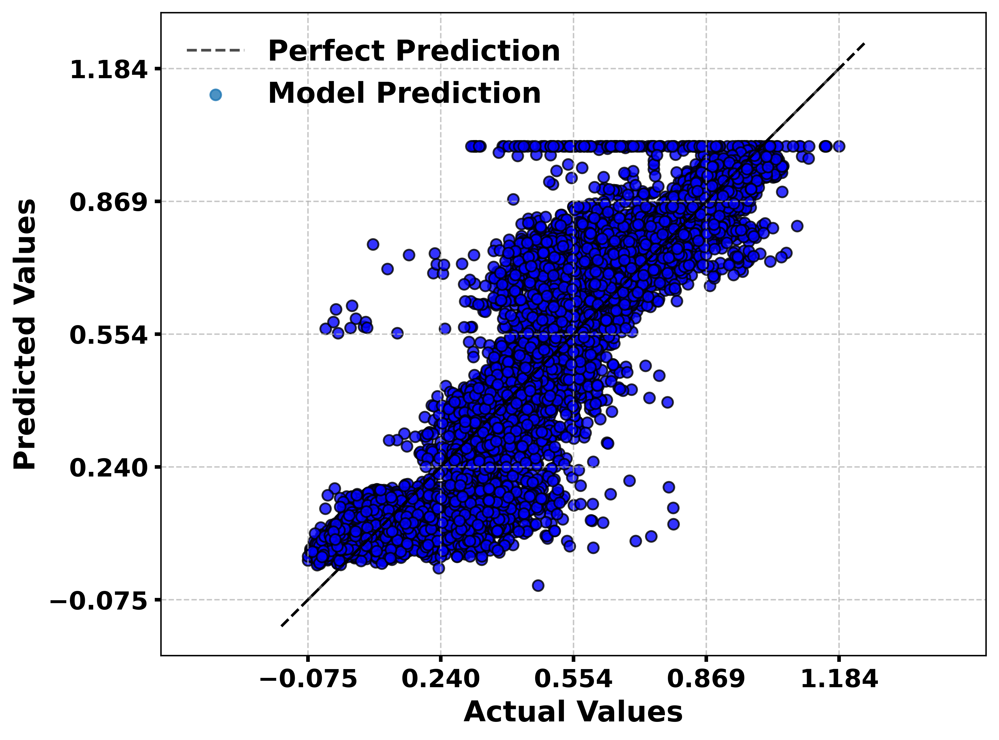

R² Score: 0.7303
Mean Absolute Error (MAE): 0.0788
Mean Squared Error (MSE): 0.0127
Explained Variance Score: 0.7441



In [56]:
from sklearn import svm
from sklearn.multioutput import MultiOutputRegressor

svr_reg = MultiOutputRegressor(svm.SVR(kernel="rbf", C=100, gamma=0.1, epsilon=0.1))
svr_reg.fit(X_train_scaled, y_train_scaled)

print_metrics("SVM[R]", "Support Vector Regression Model (RBF Kernel)", svr_reg, X_test_scaled, y_test_scaled)

LINEAR


Support Vector Regression Model (Linear Kernel)
-----------------------------------------------


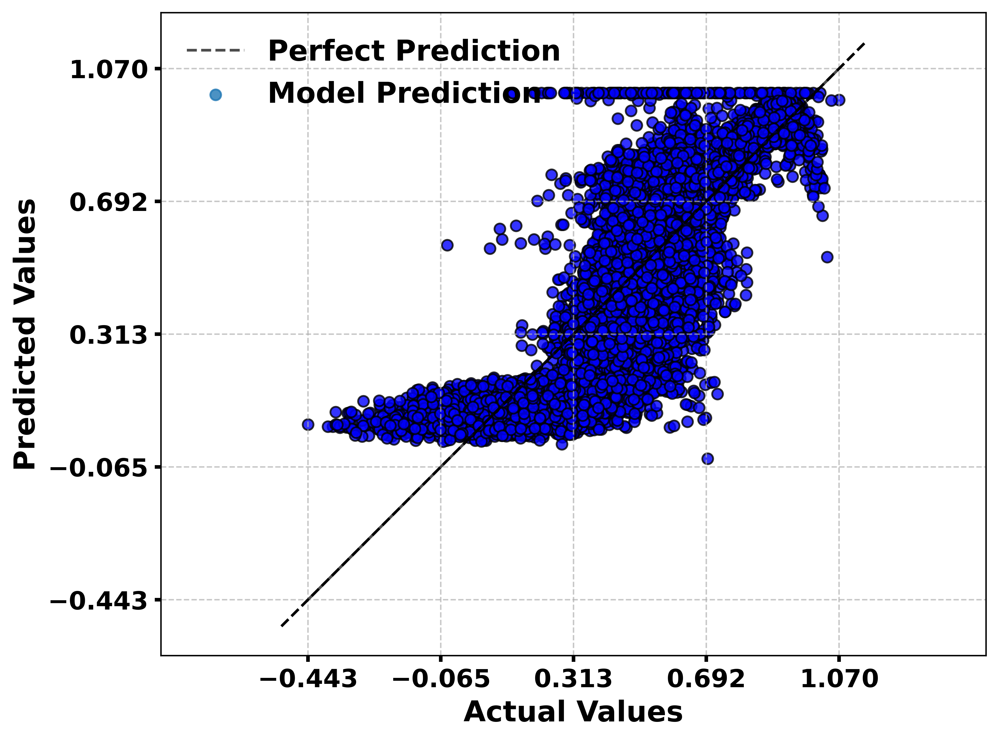

R² Score: 0.4525
Mean Absolute Error (MAE): 0.1162
Mean Squared Error (MSE): 0.0235
Explained Variance Score: 0.4973



In [57]:
from sklearn import svm
from sklearn.multioutput import MultiOutputRegressor

svr_reg = MultiOutputRegressor(svm.SVR(kernel="linear", C=100, gamma="auto"))
svr_reg.fit(X_train_scaled, y_train_scaled)

print_metrics("SVM[L]", "Support Vector Regression Model (Linear Kernel)", svr_reg, X_test_scaled, y_test_scaled)

POLYNOMIAL


Support Vector Regression Model (Polynomial Kernel)
---------------------------------------------------


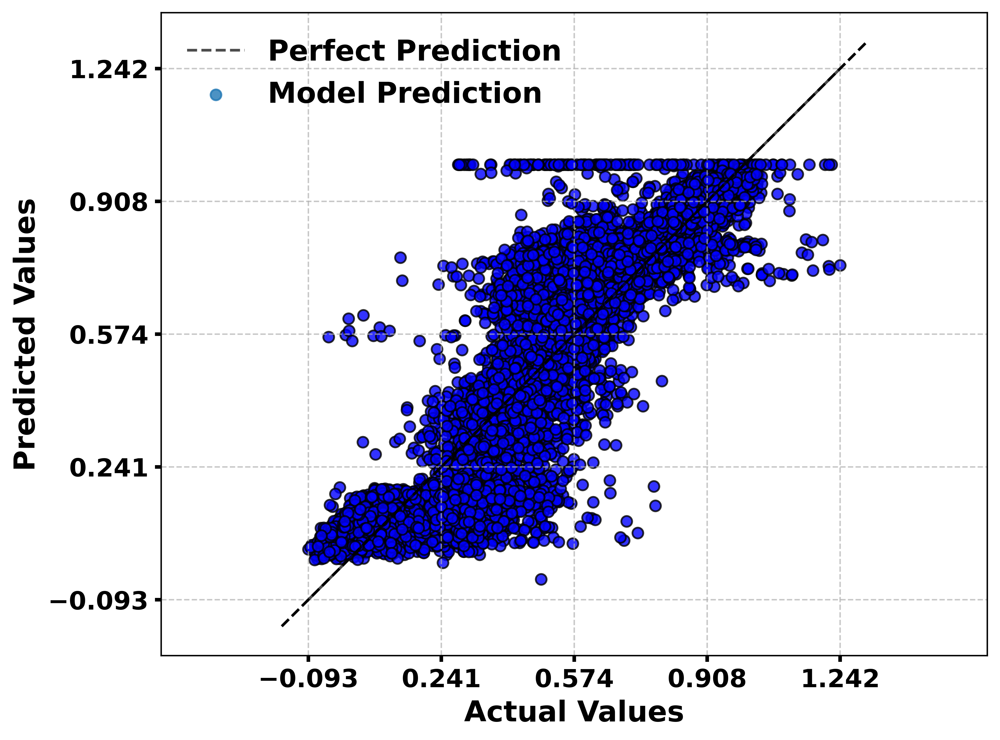

R² Score: 0.6972
Mean Absolute Error (MAE): 0.0851
Mean Squared Error (MSE): 0.0147
Explained Variance Score: 0.7123



In [58]:
from sklearn import svm
from sklearn.multioutput import MultiOutputRegressor

svr_reg = MultiOutputRegressor(svm.SVR(kernel="poly", C=100, gamma="auto", degree=3, epsilon=0.1, coef0=1))
svr_reg.fit(X_train_scaled, y_train_scaled)

print_metrics("SVM[P]", "Support Vector Regression Model (Polynomial Kernel)", svr_reg, X_test_scaled, y_test_scaled)

## KNN


K-Nearest Neighbors Regression Model
------------------------------------


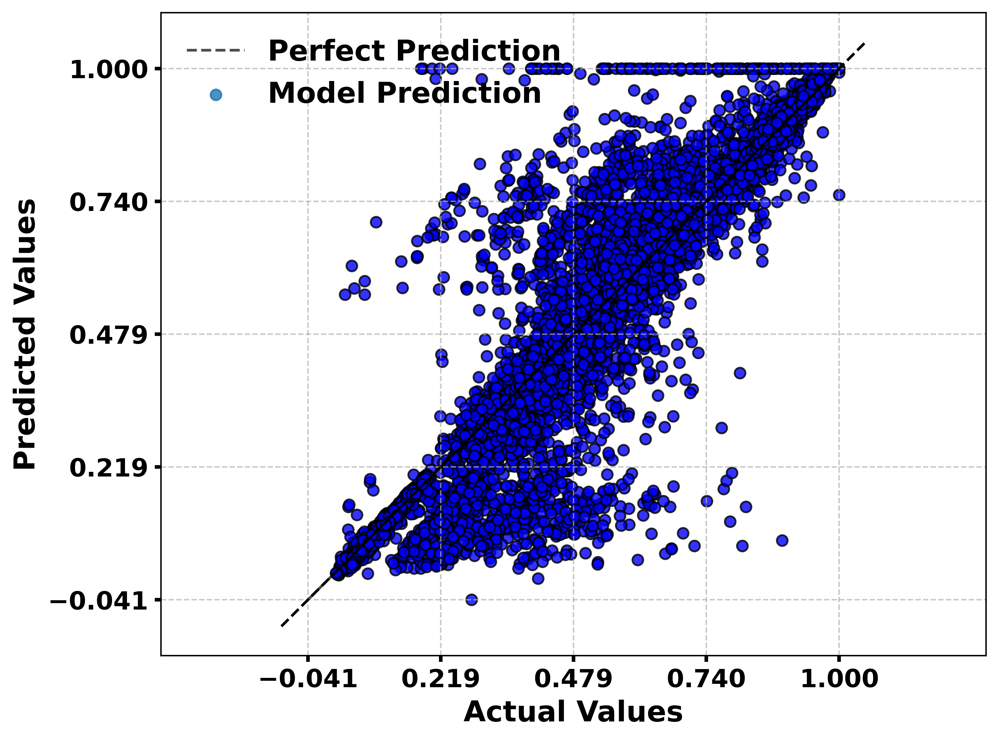

R² Score: 0.8278
Mean Absolute Error (MAE): 0.0512
Mean Squared Error (MSE): 0.0102
Explained Variance Score: 0.8278



In [59]:
from sklearn import neighbors

n_neighbors = 5

knn_reg = neighbors.KNeighborsRegressor(n_neighbors, weights="distance")
knn_reg.fit(X_train_scaled, y_train_scaled)

print_metrics("KNN", "K-Nearest Neighbors Regression Model", knn_reg, X_test_scaled, y_test_scaled)

### DECISION TREE


Decision Tree Regression Model
------------------------------


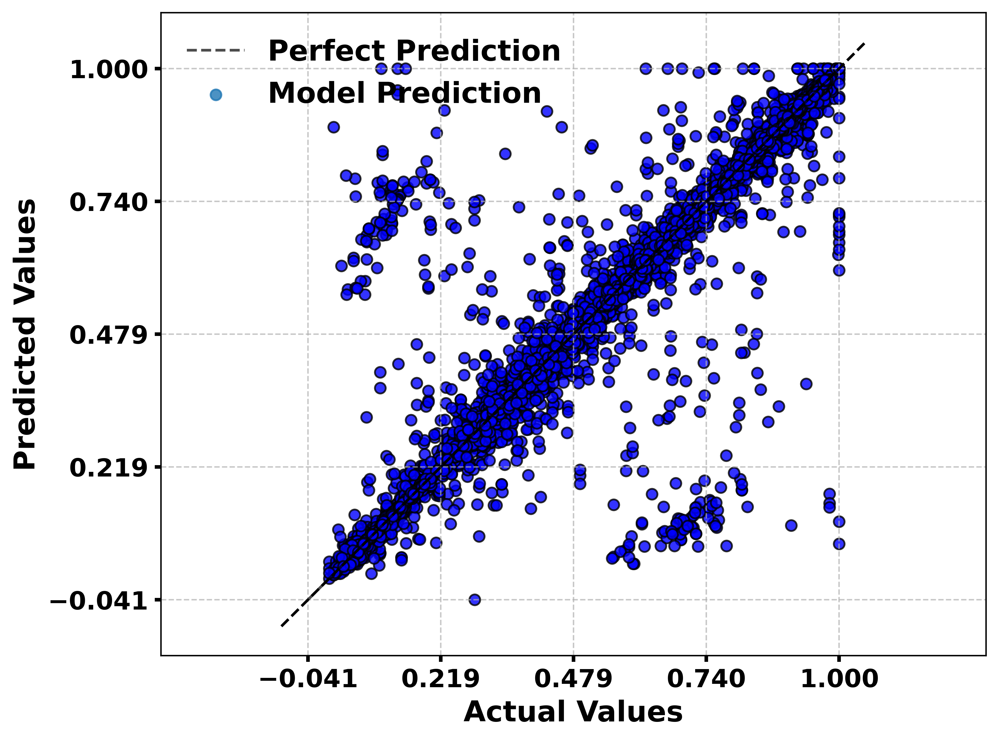

R² Score: 0.8887
Mean Absolute Error (MAE): 0.0216
Mean Squared Error (MSE): 0.0066
Explained Variance Score: 0.8887



In [60]:
from sklearn import tree

clf = tree.DecisionTreeRegressor()
clf.fit(X_train_scaled, y_train_scaled)

print_metrics("DecisionTree", "Decision Tree Regression Model", clf, X_test_scaled, y_test_scaled)

### RANDOM FOREST


Random Forest Regression Model
------------------------------


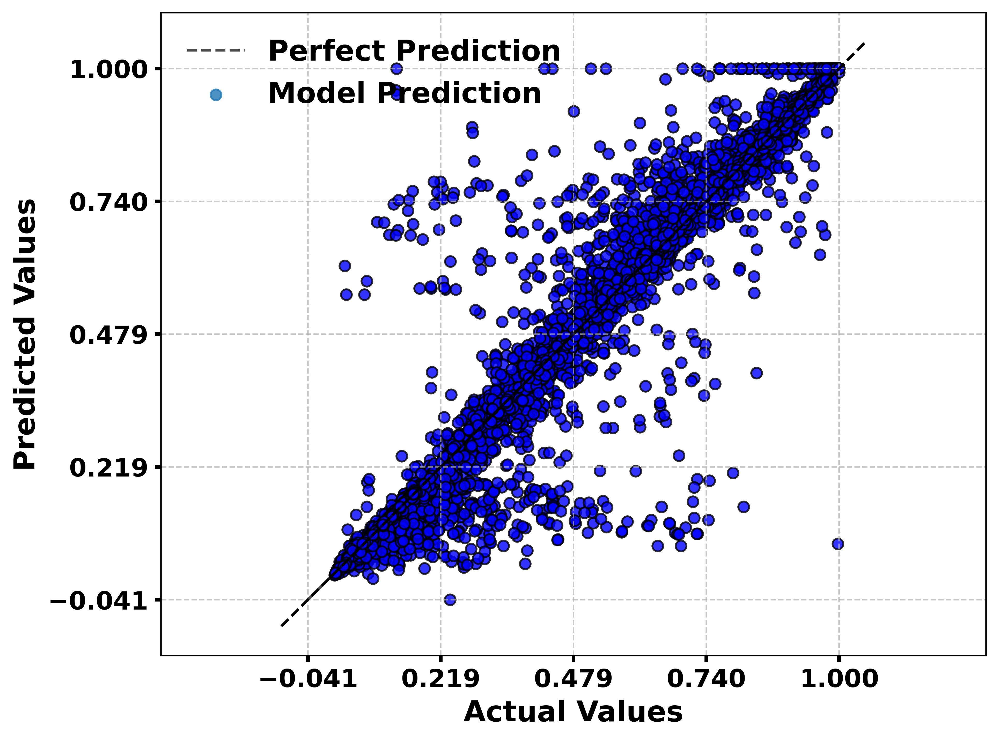

R² Score: 0.9343
Mean Absolute Error (MAE): 0.0217
Mean Squared Error (MSE): 0.0040
Explained Variance Score: 0.9344



In [61]:
from sklearn.ensemble import RandomForestRegressor

rf_reg = RandomForestRegressor(n_estimators=100, random_state=42)
rf_reg.fit(X_train_scaled, y_train_scaled)

print_metrics("RandomForest", "Random Forest Regression Model", rf_reg, X_test_scaled, y_test_scaled)